<a href="https://colab.research.google.com/github/agrpriyank2807/univ.ai.hack_1/blob/main/Uni_AI_Hackathon.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from statsmodels.stats.outliers_influence import variance_inflation_factor 
import sys
import graphviz
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn import tree
from sklearn.model_selection import train_test_split,GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, confusion_matrix, roc_curve, roc_auc_score
from sklearn.externals.six import StringIO  
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
import xgboost as xgb
import pickle
from xgboost import XGBClassifier
from sklearn import metrics
from sklearn.metrics import accuracy_score
from sklearn.naive_bayes import GaussianNB
from sklearn.preprocessing import LabelEncoder
from keras.utils import to_categorical
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import StratifiedKFold
from sklearn.ensemble import AdaBoostClassifier
from sklearn.datasets import make_classification
from sklearn.metrics import roc_auc_score
from sklearn.preprocessing import label_binarize
from sklearn.metrics import roc_curve,auc
from sklearn.metrics import confusion_matrix
from matplotlib import pyplot as plt
import time
import keras
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LeakyReLU,PReLU,ELU
from keras.layers import Dropout
import matplotlib.pyplot as plt
from keras.utils import to_categorical
from tensorflow import keras
from tensorflow.keras import layers
!pip install -q -U keras-tuner
from kerastuner.tuners import RandomSearch
from sklearn.preprocessing import OneHotEncoder 
from sklearn.compose import ColumnTransformer
from keras.wrappers.scikit_learn import KerasClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.metrics import roc_auc_score
from keras.utils import np_utils

In [ ]:
train_data=pd.read_csv('/content/drive/MyDrive/Univ.AI_hackathon/Training Data.csv')

In [ ]:
train_data.describe()

,Id,income,age,experience,current_job_years,current_house_years,risk_flag
count,252000.000000,2.520000e+05,252000.000000,252000.000000,252000.000000,252000.000000,252000.000000
mean,126000.500000,4.997117e+06,49.954071,10.084437,6.333877,11.997794,0.123000
std,72746.278255,2.878311e+06,17.063863,6.002590,3.647053,1.399037,0.328438
min,1.000000,1.031000e+04,21.000000,0.000000,0.000000,10.000000,0.000000
25%,63000.750000,2.503015e+06,35.000000,5.000000,3.000000,11.000000,0.000000
50%,126000.500000,5.000694e+06,50.000000,10.000000,6.000000,12.000000,0.000000
75%,189000.250000,7.477502e+06,65.000000,15.000000,9.000000,13.000000,0.000000
max,252000.000000,9.999938e+06,79.000000,20.000000,14.000000,14.000000,1.000000


In [ ]:
train_data=train_data.drop(columns=['Id'])
le=LabelEncoder()
train_data['married']=(le.fit_transform(train_data['married'].astype('str')))
train_data['house_ownership']=le.fit_transform(train_data['house_ownership'].astype('str'))
train_data['car_ownership']=le.fit_transform(train_data['car_ownership'].astype('str'))
train_data['profession']=le.fit_transform(train_data['profession'].astype('str'))
train_data['city']=le.fit_transform(train_data['city'].astype('str'))
train_data['state']=le.fit_transform(train_data['state'].astype('str'))
train_x=train_data.drop(columns=['risk_flag'])
train_y=train_data['risk_flag']

In [ ]:
traindata_corr = train_data.corr()[:-1]
traindata_corr

,income,age,experience,married,house_ownership,car_ownership,profession,city,state,current_job_years,current_house_years,risk_flag
income,1.000000,-0.000652,0.006422,0.002682,0.016433,0.004068,0.000725,-0.001919,-0.004067,0.007045,-0.002397,-0.003091
age,-0.000652,1.000000,-0.001118,-0.005324,-0.009820,0.009395,-0.008552,0.002104,-0.004985,0.002154,-0.020134,-0.021809
experience,0.006422,-0.001118,1.000000,-0.001752,-0.007912,0.007519,0.000975,-0.025703,-0.001251,0.646098,0.019309,-0.034523
married,0.002682,-0.005324,-0.001752,1.000000,-0.022501,0.001206,-0.007534,0.012280,-0.009477,0.004251,-0.007539,0.021092
house_ownership,0.016433,-0.009820,-0.007912,-0.022501,1.000000,-0.001233,0.001242,-0.014447,-0.007792,-0.009790,-0.005618,0.023622
car_ownership,0.004068,0.009395,0.007519,0.001206,-0.001233,1.000000,0.011887,0.001648,0.026000,0.011099,0.000251,-0.024036
profession,0.000725,-0.008552,0.000975,-0.007534,0.001242,0.011887,1.000000,0.018852,0.001557,-0.004536,0.001954,-0.004900
city,-0.001919,0.002104,-0.025703,0.012280,-0.014447,0.001648,0.018852,1.000000,-0.038040,-0.027353,-0.010654,0.004575
state,-0.004067,-0.004985,-0.001251,-0.009477,-0.007792,0.026000,0.001557,-0.038040,1.000000,0.008745,0.007281,-0.003401
current_job_years,0.007045,0.002154,0.646098,0.004251,-0.009790,0.011099,-0.004536,-0.027353,0.008745,1.000000,0.005372,-0.016942


In [ ]:
train_data.head()

,income,age,experience,married,house_ownership,car_ownership,profession,city,state,current_job_years,current_house_years,risk_flag
0,1303835,23,3,1,2,0,33,251,13,3,13,0
1,7574516,40,10,1,2,0,43,227,14,9,13,0
2,3991815,66,4,0,2,0,47,8,12,4,10,0
3,6256451,41,2,1,2,1,43,54,17,2,12,1
4,5768871,47,11,1,2,0,11,296,22,3,14,1


In [ ]:
# fig=plt.figure(figsize=(40,20), facecolor='white')
# plotnumber = 1

# for column in train_data:
#     if plotnumber<=12 :     # as there are 12 columns in the data
#         ax = plt.subplot(3,4,plotnumber)
#         sns.distplot(train_data[column])
#         plt.xlabel(column,fontsize=30)
#         plt.ylabel('Density',fontsize=30)
#     plotnumber+=1
# fig.show()
# fig.savefig('distribution_plot.png')

In [ ]:
# scalar = StandardScaler()
# X_scaled = scalar.fit_transform(train_x)
# vif = pd.DataFrame()
# vif["vif"] = [variance_inflation_factor(X_scaled,i) for i in range(X_scaled.shape[1])]
# vif["Features"] = train_x.columns
# print("The VIF for the given dataset is\n",vif)

# Anamoly detection


In [ ]:
# To check the number of anamoly(1) and normal(0) in the class variable
# Normal variable are all the values of class with value 0. It is the normal data point. On the other hand class with value one it shows the outliers in the class feature.

normal = train_data[train_data['risk_flag'] == 0]
anomaly = train_data[train_data['risk_flag'] == 1]

# Understanding the shape of the normal and anamoly data

print(normal.shape)
print(anomaly.shape)

(221004, 12)
(30996, 12)


In [ ]:
total = train_data.isnull().sum().sort_values(ascending=False)
percent = (train_data.isnull().sum()/train_data.isnull().count()).sort_values(ascending=False)
missing_data = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
missing_data

,Total,Percent
risk_flag,0,0.0
current_house_years,0,0.0
current_job_years,0,0.0
state,0,0.0
city,0,0.0
profession,0,0.0
car_ownership,0,0.0
house_ownership,0,0.0
married,0,0.0
experience,0,0.0


In [ ]:
# Making a class for defining the model fitting  and making the function for prediction model

class hist_model(object):
    
    def __init__(self, bins=50):
        self.bins = bins
        
    def fit(self, X):
        
        bin_hight, bin_edge = [], []
        
        for var in X.T:
            # get bins hight and interval
            bh, bedge = np.histogram(var, bins=self.bins)
            bin_hight.append(bh)
            bin_edge.append(bedge)
        
        self.bin_hight = np.array(bin_hight)
        self.bin_edge = np.array(bin_edge)
   

    def predict(self, X):
        
        scores = []
        for obs in X:
            obs_score = []
            for i, var in enumerate(obs):
                # find wich bin obs is in
                bin_num = (var > self.bin_edge[i]).argmin()-1
                obs_score.append(self.bin_hight[i, bin_num]) # find bin hitght
            
            scores.append(np.mean(obs_score))
        
        return np.array(scores)
                
#fitting the model
        
model = hist_model()
model.fit(train_data.drop('risk_flag', axis=1).values)


In [ ]:
from scipy.stats import multivariate_normal


mu = train_data.drop('risk_flag', axis=1).mean(axis=0).values
sigma = train_data.drop('risk_flag', axis=1).cov().values
model = multivariate_normal(cov=sigma, mean=mu, allow_singular=True)

In [ ]:
# Applying Gaussian Mixture Algorithm for model fitting
from sklearn.mixture import GaussianMixture

gmm = GaussianMixture(n_components=3, n_init=4, random_state=42)
gmm.fit(train_data.drop('risk_flag', axis=1).values)
print(gmm.score(train_data[train_data['risk_flag'] == 0].drop('risk_flag', axis=1).values))
print(gmm.score(train_data[train_data['risk_flag'] == 1].drop('risk_flag', axis=1).values))

KeyboardInterrupt: ignored

In [ ]:
Fraud = train_data[train_data['risk_flag']==1]
Valid = train_data[train_data['risk_flag']==0]
outlier_fraction = len(Fraud)/float(len(Valid))
print(outlier_fraction)

In [ ]:
# Making a classifier using oneClassSVM algorithm.

from sklearn.svm import OneClassSVM
from sklearn.ensemble import IsolationForest
from sklearn.neighbors import LocalOutlierFactor

classifiers = {
    "Isolation Forest":IsolationForest(n_estimators=100, max_samples=len(train_data),contamination=outlier_fraction, 
                                       random_state = 0, verbose=0),
    "Local Outlier Factor":LocalOutlierFactor(n_neighbors=20, algorithm='auto',contamination=outlier_fraction,  
                                              leaf_size=30, metric='minkowski',
                                              p=2, metric_params=None),
    "Support Vector Machine":OneClassSVM(kernel='rbf', degree=3, gamma=0.1,nu=0.05, 
                                         max_iter=-1)
   
}



In [ ]:
from sklearn.metrics import classification_report,accuracy_score
columns = train_data.columns.tolist()
# Filter the columns to remove data we do not want 
columns = [c for c in columns if c not in ["risk_flag"]]
# Store the variable we are predicting 
target = "risk_flag"

X = train_data[columns]
Y = train_data[target]
n_outliers = len(Fraud)
for i, (clf_name,clf) in enumerate(classifiers.items()):
    #Fit the data and tag outliers
    if clf_name == "Local Outlier Factor":
        y_pred = clf.fit_predict(X)
        scores_prediction = clf.negative_outlier_factor_
    elif clf_name == "Support Vector Machine":
        clf.fit(X)
        y_pred = clf.predict(X)
    else:    
        clf.fit(X)
        scores_prediction = clf.decision_function(X)
        y_pred = clf.predict(X)
    #Reshape the prediction values to 0 for Valid transactions , 1 for Fraud transactions
    y_pred[y_pred == 1] = 0
    y_pred[y_pred == -1] = 1
    n_errors = (y_pred != Y).sum()
    # Run Classification Metrics
    print("{}: {}".format(clf_name,n_errors))
    print("Accuracy Score :")
    print(accuracy_score(Y,y_pred))
    print("Classification Report :")
    print(classification_report(Y,y_pred))


Isolation Forest: 56064
Accuracy Score :
0.7775238095238095
Classification Report :
              precision    recall  f1-score   support

           0       0.88      0.86      0.87    221004
           1       0.15      0.17      0.15     30996

    accuracy                           0.78    252000
   macro avg       0.51      0.51      0.51    252000
weighted avg       0.79      0.78      0.78    252000

Local Outlier Factor: 52096
Accuracy Score :
0.7932698412698412
Classification Report :
              precision    recall  f1-score   support

           0       0.89      0.87      0.88    221004
           1       0.20      0.23      0.21     30996

    accuracy                           0.79    252000
   macro avg       0.55      0.55      0.55    252000
weighted avg       0.81      0.79      0.80    252000



KeyboardInterrupt: ignored

In [ ]:
predic=pd.DataFrame()
for i in range(len(test_data)):
  df=test_data.iloc[[i]]
  df=df.to_numpy()
  pred_val=clf.predict(df)
  pred_val=pd.DataFrame(pred_val)
  predic=predic.append(pred_val,ignore_index=True)

In [ ]:
predic.to_csv('anamoly_detection.csv')

# Test Data


In [ ]:
test_data=pd.read_csv('/content/drive/MyDrive/Univ.AI_hackathon/Test Data.csv')

In [ ]:
test_data=test_data.drop(columns='id',axis=1)
test_data.head()

,income,age,experience,married,house_ownership,car_ownership,profession,city,state,current_job_years,current_house_years
0,7393090,59,19,single,rented,no,Geologist,Malda,West Bengal,4,13
1,1215004,25,5,single,rented,no,Firefighter,Jalna,Maharashtra,5,10
2,8901342,50,12,single,rented,no,Lawyer,Thane,Maharashtra,9,14
3,1944421,49,9,married,rented,yes,Analyst,Latur,Maharashtra,3,12
4,13429,25,18,single,rented,yes,Comedian,Berhampore,West Bengal,13,11


In [ ]:

test_data['married']=(le.fit_transform(test_data['married'].astype('str')))
test_data['house_ownership']=le.fit_transform(test_data['house_ownership'].astype('str'))
test_data['car_ownership']=le.fit_transform(test_data['car_ownership'].astype('str'))
test_data['profession']=le.fit_transform(test_data['profession'].astype('str'))
test_data['city']=le.fit_transform(test_data['city'].astype('str'))
test_data['state']=le.fit_transform(test_data['state'].astype('str'))

In [ ]:
test_data.describe()

,income,age,experience,married,house_ownership,car_ownership,profession,city,state,current_job_years,current_house_years
count,2.800000e+04,28000.000000,28000.000000,28000.000000,28000.000000,28000.000000,28000.000000,28000.000000,28000.000000,28000.000000,28000.000000
mean,5.029563e+06,50.054679,10.120393,0.898929,1.894286,0.299107,25.260607,158.144429,13.732143,6.339286,11.991786
std,2.864938e+06,17.129879,6.027317,0.301429,0.386247,0.457875,14.740652,92.196406,9.421404,3.645222,1.397754
min,1.031000e+04,21.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,10.000000
25%,2.545414e+06,35.000000,5.000000,1.000000,2.000000,0.000000,13.000000,78.000000,5.000000,3.000000,11.000000
50%,5.046744e+06,50.000000,10.000000,1.000000,2.000000,0.000000,25.000000,158.000000,14.000000,6.000000,12.000000
75%,7.474639e+06,65.000000,15.000000,1.000000,2.000000,1.000000,38.000000,238.000000,22.000000,9.000000,13.000000
max,9.999814e+06,79.000000,20.000000,1.000000,2.000000,1.000000,50.000000,316.000000,28.000000,14.000000,14.000000


In [ ]:
test_data.head()

,income,age,experience,married,house_ownership,car_ownership,profession,city,state,current_job_years,current_house_years
0,7393090,59,19,1,2,0,26,181,28,4,13
1,1215004,25,5,1,2,0,24,131,14,5,10
2,8901342,50,12,1,2,0,30,290,14,9,14
3,1944421,49,9,0,2,1,1,171,14,3,12
4,13429,25,18,1,2,1,12,39,28,13,11


In [ ]:
x_train,x_test,y_train,y_test = train_test_split(train_x,train_y,test_size = 0.20, random_state= 355)
y_train=pd.DataFrame(y_train)
y_test=pd.DataFrame(y_test)

In [ ]:
scalar = StandardScaler()
x_train_scaled = scalar.fit_transform(x_train)
x_test_scaled=scalar.transform(x_test)

# Visualization

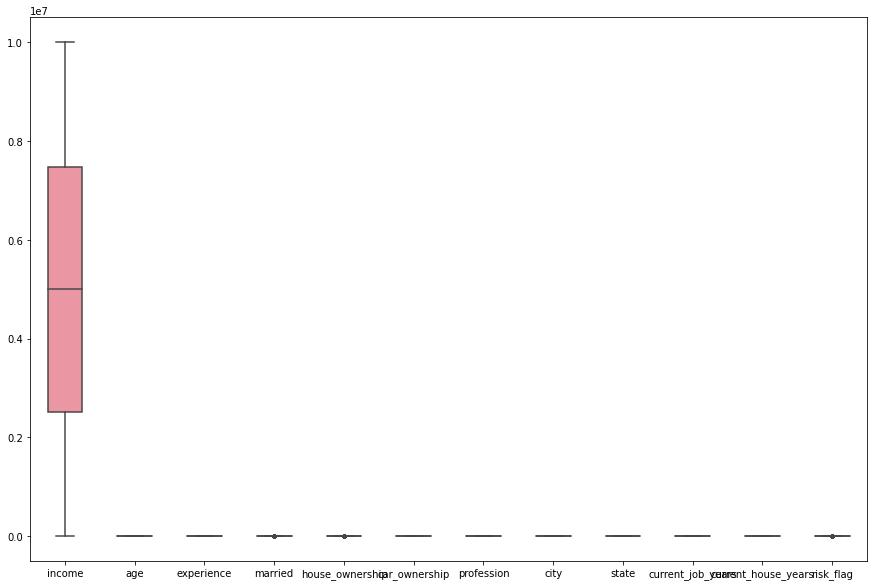

In [ ]:
fig, ax = plt.subplots(figsize=(15,10))
sns.boxplot(data=train_data, width= 0.5,ax=ax,  fliersize=3)

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning

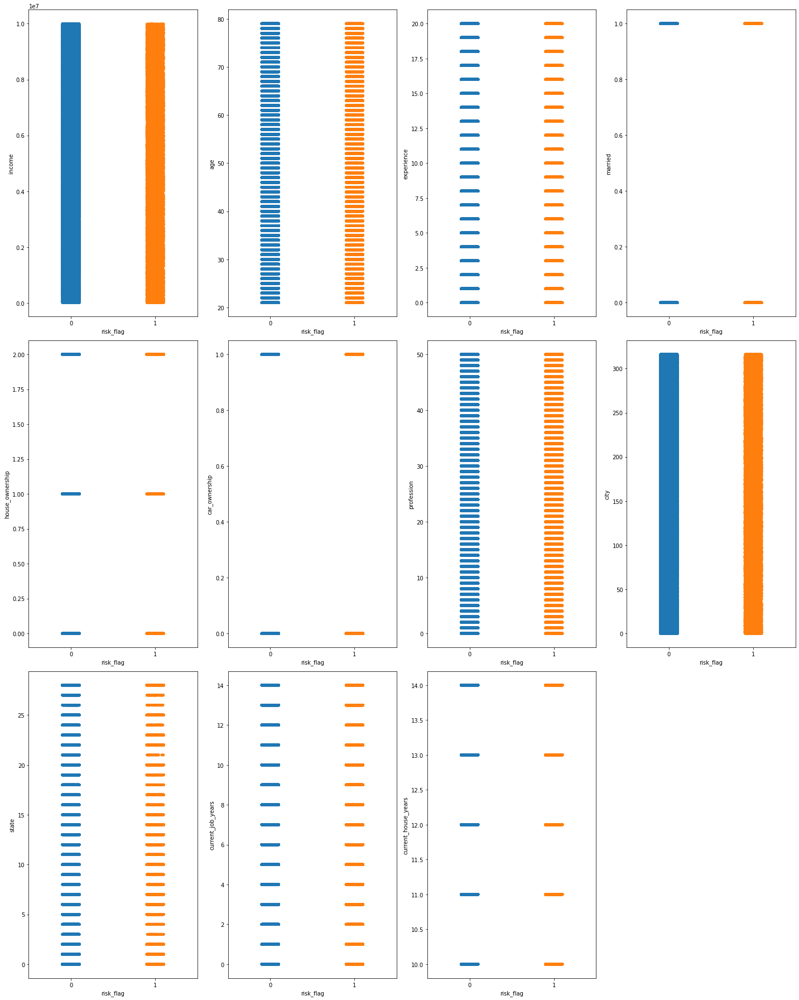

In [ ]:
plt.figure(figsize=(20,25), facecolor='white')
plotnumber = 1

for column in train_x:
    if plotnumber<=11 :
        ax = plt.subplot(3,4,plotnumber)
        sns.stripplot(train_y,train_x[column])
    plotnumber+=1
plt.tight_layout()

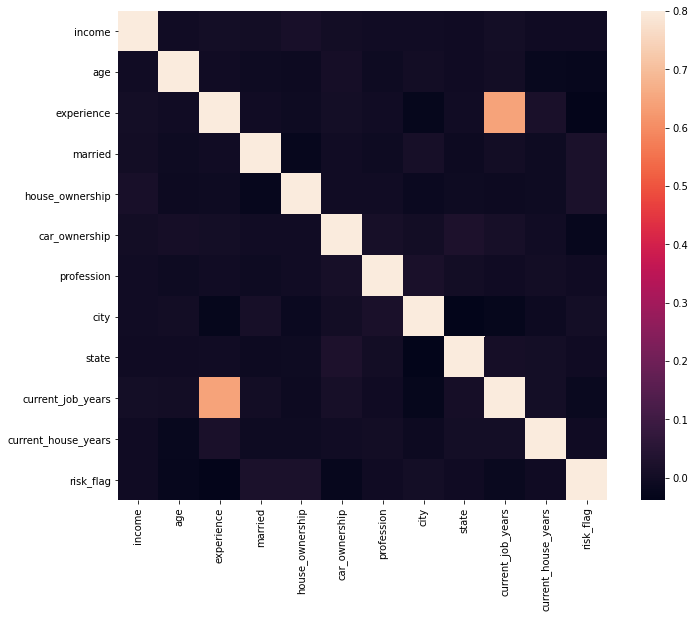

In [ ]:
correlation_matrix = train_data.corr()
fig = plt.figure(figsize=(12,9))
sns.heatmap(correlation_matrix,vmax=0.8,square = True)
plt.show()

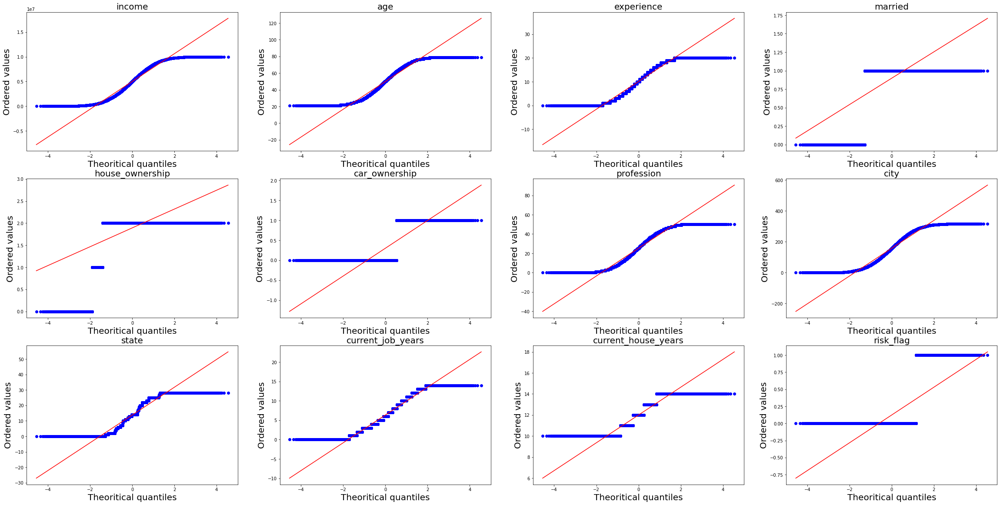

In [ ]:
from scipy import stats
import matplotlib.pyplot as plt
fig= plt.figure(figsize=(40,20), facecolor='white')
plt_number=1
for columns in train_data:
  if(plt_number<=12):
    ax = plt.subplot(3,4,plt_number)
    res = stats.probplot(train_data[columns],plot=plt)
    plt.title(columns,fontsize=20)
    plt.xlabel('Theoritical quantiles',fontsize=20)
    plt.ylabel('Ordered values',fontsize=20)
    plt_number+=1
fig.show()

In [ ]:
train_data.skew()

income                 0.005958
age                   -0.005315
experience            -0.012779
married               -2.628414
house_ownership       -3.791456
car_ownership          0.864648
profession            -0.028475
city                   0.006254
state                  0.001785
current_job_years      0.273146
current_house_years    0.006786
risk_flag              2.295734
dtype: float64

In [ ]:
train_data.kurtosis()

income                 -1.198639
age                    -1.204770
experience             -1.194939
married                 4.908601
house_ownership        13.860526
car_ownership          -1.252393
profession             -1.201818
city                   -1.211220
state                  -1.321631
current_job_years      -0.785973
current_house_years    -1.274949
risk_flag               3.270421
dtype: float64

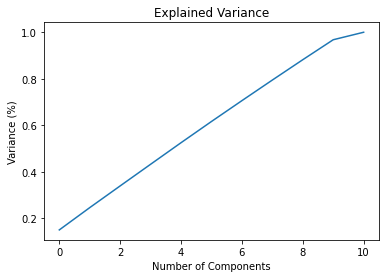

In [ ]:
from sklearn.decomposition import PCA
import plotly.express as px
pca = PCA()
principalComponents = pca.fit_transform(x_train_scaled)
plt.figure()
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Components')
plt.ylabel('Variance (%)') #for each component
plt.title('Explained Variance')
plt.show()

In [ ]:
!pip install -q dash
!pip install -q dash_core_components
!pip install -q dash_html_components
!pip install -q dash_table
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output
import pandas as pd
import plotly.express as px
from sklearn.decomposition import PCA
from sklearn.datasets import load_boston


app = dash.Dash(__name__)

app.layout = html.Div([
    dcc.Graph(id="graph"),
    html.P("Number of components:"),
    dcc.Slider(
        id='slider',
        min=2, max=5, value=3,
        marks={i: str(i) for i in range(2,6)})
])

@app.callback(
    Output("graph", "figure"), 
    [Input("slider", "value")])
def run_and_plot(n_components):

    pca = PCA(n_components=n_components)
    components = pca.fit_transform(df)

    var = pca.explained_variance_ratio_.sum() * 100

    labels = {str(i): f"PC {i+1}" 
              for i in range(n_components)}
    labels['color'] = 'Median Price'

    fig = px.scatter_matrix(
        components,
        color=boston.target,
        dimensions=range(n_components),
        labels=labels,
        title=f'Total Explained Variance: {var:.2f}%')
    fig.update_traces(diagonal_visible=False)
    return fig

app.run_server(debug=True)

     |████████████████████████████████| 81kB 2.3MB/s 
     |████████████████████████████████| 1.0MB 4.3MB/s 
     |████████████████████████████████| 3.5MB 7.8MB/s 
     |████████████████████████████████| 92kB 6.3MB/s 
     |████████████████████████████████| 1.8MB 19.9MB/s 
     |████████████████████████████████| 358kB 33.8MB/s 


NameError: ignored

In [ ]:
import plotly.express as px

features = train_x.columns

fig = px.scatter_matrix(
    train_data,
    dimensions=features,
    color="risk_flag"
)
fig.update_traces(diagonal_visible=False)
fig.show()

In [ ]:
import plotly.express as px
from sklearn.decomposition import PCA

features = train_x.columns

pca = PCA()
components = pca.fit_transform(train_data[features])
labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca.explained_variance_ratio_ * 100)
}

fig = px.scatter_matrix(
    components,
    labels=labels,
    dimensions=range(4),
    color=train_data["risk_flag"]
)
fig.update_traces(diagonal_visible=False)
fig.show()

# XG-Boost Classifier

In [ ]:
start = time.time()
xgb = XGBClassifier()
xgb.fit(x_train.values,y_train.values)
print(xgb.score(x_test.values,y_test.values))
print(xgb.score(x_train.values,y_train.values))
end = time.time()
print(end - start)

/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:235: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:268: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.8766071428571428
0.8772222222222222
12.265512466430664


In [ ]:
predic=pd.DataFrame()
for i in range(len(test_data)):
  df=test_data.iloc[[i]]
  df=df.to_numpy()
  pred_val=xgb.predict(df)
  print(df,pred_val)

Streaming output truncated to the last 5000 lines.
       12      11]] [0]
[[5647627      46       2       1       2       0      37     257      22
        2      11]] [0]
[[2889903      27       0       1       2       0      25     162      28
        0      12]] [0]
[[7624918      34      20       1       2       0      40     201      11
        7      12]] [0]
[[7325901      74      12       1       2       1      32     154      23
       12      13]] [0]
[[2548584      42      13       1       2       0      32     147      22
       13      13]] [0]
[[4080051      57      11       1       2       1      24     288       0
        4      14]] [0]
[[4281675      65      15       1       2       0      33     172      25
        6      11]] [0]
[[1977577      37       5       1       0       0      26     300      22
        4      14]] [0]
[[690298     27      4      1      2      0      8    243      6      4
      12]] [0]
[[4485547      33      20       1       2       0     

KeyboardInterrupt: ignored

In [ ]:
x_test.head()

,income,age,experience,married,house_ownership,car_ownership,profession,city,state,current_job_years,current_house_years
181174,2018172,73,15,1,2,0,24,299,22,3,12
237721,5772081,31,10,1,2,0,26,299,22,10,10
51684,962072,25,14,1,2,1,15,230,19,4,11
5757,8693161,53,5,0,2,1,29,234,0,3,10
70797,6129612,42,13,1,1,0,34,12,0,6,12


In [ ]:
type(y_test)

pandas.core.series.Series

In [ ]:
predic.to_csv('Predictions.csv')

In [ ]:
xgb.predict([[6256451,41,2,1,2,1,43,54,17,2,12]])

array([0])

# Decision Tree Classifier

In [ ]:
clf = DecisionTreeClassifier()
clf=clf.fit(x_train,y_train)

In [ ]:
print("Training accuracy=",clf.score(x_train,y_train))
print("Testing accuracy=",clf.score(x_test,y_test))

In [ ]:
clf.predict([[5768871,47,11,1,2,0,11,296,22,3,14]])

Let us do the Hyper-parameter tuning for this model

In [ ]:
clf=DecisionTreeClassifier()
grid_param = {
    'criterion': ['gini', 'entropy'],
    'max_depth' : range(2,32,1),
    'min_samples_leaf' : range(1,10,1),
    'min_samples_split': range(2,10,1),
    'splitter' : ['best', 'random']
             }
grid_search = GridSearchCV(estimator=clf,
                     param_grid=grid_param,
                     cv=10,
                    n_jobs =-1)
grid_search.fit(x_train,y_train)


In [ ]:
best_parameters = grid_search.best_params_
print(best_parameters)
print(grid_search.best_score_)

In [ ]:
predic=pd.DataFrame()
for i in range(len(test_data)):
  df=test_data.iloc[[i]]
  df=df.to_numpy()
  pred_val=clf.predict(df)
  pred_val=pd.DataFrame(pred_val)
  predic=predic.append(pred_val,ignore_index=True)

In [ ]:
predic.to_csv('predictions(dt).csv')

In [ ]:
predic.describe()

# Random Forest Classifier

In [ ]:
rf=RandomForestClassifier(n_estimators=150)
rf.fit(x_train,y_train)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=150,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [ ]:
print("Training accuracy=",rf.score(x_train,y_train))
print("Test accuracy=",rf.score(x_test,y_test))
print('ROC Score=',roc_auc_score(y_test, rf.predict(x_test)))

Training accuracy= 0.9362698412698413
Test accuracy= 0.9
ROC Score= 0.7419123459422418


In [ ]:
sample_leaf_options = [1,2,3,4,5,10,20]

# for loop to iterate for each leaf size
for leaf_size in sample_leaf_options :
    model = RandomForestClassifier(n_estimators = 200, n_jobs = -1,random_state =50, min_samples_leaf = leaf_size)
    model.fit(x_train,y_train)
    print("\n Leaf size :", leaf_size)
    print ("AUC - ROC : ", roc_auc_score(y_test,model.predict(x_test)))
    print("Training accuracy=",model.score(x_train,y_train))
    print("Testing accuracy=",model.score(x_test,y_test))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Leaf size : 1
AUC - ROC :  0.7437961987059941
Training accuracy= 0.9362648809523809
Testing accuracy= 0.9002777777777777


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Leaf size : 2
AUC - ROC :  0.7406338946620622
Training accuracy= 0.9160912698412699
Testing accuracy= 0.9001785714285714


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Leaf size : 3
AUC - ROC :  0.7390804857224527
Training accuracy= 0.9075446428571429
Testing accuracy= 0.9002380952380953


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Leaf size : 4
AUC - ROC :  0.7362033520510154
Training accuracy= 0.907420634920635
Testing accuracy= 0.9003968253968254


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Leaf size : 5
AUC - ROC :  0.7333295353291206
Training accuracy= 0.9073908730158731
Testing accuracy= 0.9001984126984127


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Leaf size : 10
AUC - ROC :  0.722633187744465
Training accuracy= 0.9071527777777778
Testing accuracy= 0.900079365079365


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Leaf size : 20
AUC - ROC :  0.677843603385011
Training accuracy= 0.9048958333333333
Testing accuracy= 0.897420634920635


In [ ]:
n_estimators = [100,150,200,300,400,500]

# for loop to iterate for each leaf size
for estimators in n_estimators :
    model = RandomForestClassifier(n_estimators = estimators, n_jobs = -1,random_state =50, min_samples_leaf = 1)
    model.fit(x_train,y_train)
    print("\n Estimators :", estimators)
    print ("AUC - ROC : ", roc_auc_score(y_test,model.predict(x_test)))
    print("Training accuracy=",model.score(x_train,y_train))
    print("Testing accuracy=",model.score(x_test,y_test))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Estimators : 100
AUC - ROC :  0.7458553551626632
Training accuracy= 0.9362400793650794
Testing accuracy= 0.9002579365079365


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Estimators : 150
AUC - ROC :  0.7441175354669195
Training accuracy= 0.9362549603174604
Testing accuracy= 0.9003571428571429


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Estimators : 200
AUC - ROC :  0.7437961987059941
Training accuracy= 0.9362648809523809
Testing accuracy= 0.9002777777777777


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Estimators : 300
AUC - ROC :  0.7432327537245269
Training accuracy= 0.9362748015873016
Testing accuracy= 0.9002579365079365


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Estimators : 400
AUC - ROC :  0.742128500487417
Training accuracy= 0.9362748015873016
Testing accuracy= 0.9002579365079365


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Estimators : 500
AUC - ROC :  0.7422676377919032
Training accuracy= 0.9362748015873016
Testing accuracy= 0.9001388888888889


In [ ]:
max_features = ['auto','log2',None]

# for loop to iterate for each leaf size
for features in max_features :
    model = RandomForestClassifier(max_features= features, n_jobs = -1,random_state =50, min_samples_leaf = 1,n_estimators=100)
    model.fit(x_train,y_train)
    print("\n Features :", features)
    print ("AUC - ROC : ", roc_auc_score(y_test,model.predict(x_test)))
    print("Training accuracy=",model.score(x_train,y_train))
    print("Testing accuracy=",model.score(x_test,y_test))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Features : auto
AUC - ROC :  0.7458553551626632
Training accuracy= 0.9362400793650794
Testing accuracy= 0.9002579365079365


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Features : log2
AUC - ROC :  0.7458553551626632
Training accuracy= 0.9362400793650794
Testing accuracy= 0.9002579365079365


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Features : None
AUC - ROC :  0.7459955981169968
Training accuracy= 0.9362450396825397
Testing accuracy= 0.9000198412698412


In [ ]:
max_depth = [2,4,6,8,10,12,14,16,20]

# for loop to iterate for each leaf size
for depth in max_depth :
    model = RandomForestClassifier(max_features= None, n_jobs = -1,random_state =50, min_samples_leaf = 1,n_estimators=100,max_depth=depth)
    model.fit(x_train,y_train)
    print("\n Depth :", depth)
    print ("AUC - ROC : ", roc_auc_score(y_test,model.predict(x_test)))
    print("Training accuracy=",model.score(x_train,y_train))
    print("Testing accuracy=",model.score(x_test,y_test))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Depth : 2
AUC - ROC :  0.5
Training accuracy= 0.8771230158730159
Testing accuracy= 0.8765079365079365


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Depth : 4
AUC - ROC :  0.5011371026759984
Training accuracy= 0.8774503968253968
Testing accuracy= 0.8766865079365079


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Depth : 6
AUC - ROC :  0.5026532395773299
Training accuracy= 0.8777728174603174
Testing accuracy= 0.8769246031746032


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Depth : 8
AUC - ROC :  0.5100721500536763
Training accuracy= 0.8793005952380952
Testing accuracy= 0.8781944444444445


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Depth : 10
AUC - ROC :  0.5180804591868562
Training accuracy= 0.8812996031746032
Testing accuracy= 0.8791666666666667


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Depth : 12
AUC - ROC :  0.5376894792878033
Training accuracy= 0.8848759920634921
Testing accuracy= 0.8819642857142858


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Depth : 14
AUC - ROC :  0.576371133833444
Training accuracy= 0.8921626984126985
Testing accuracy= 0.8871031746031746


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Depth : 16
AUC - ROC :  0.6154011844652238
Training accuracy= 0.9007242063492064
Testing accuracy= 0.8918849206349206


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Depth : 20
AUC - ROC :  0.6753214996987977
Training accuracy= 0.9160912698412699
Testing accuracy= 0.8965079365079365


In [ ]:
min_samples_split = [2,4,6,8,10,12,14]

# for loop to iterate for each leaf size
for split in min_samples_split :
    model = RandomForestClassifier(max_features= None, n_jobs = -1,random_state =50, min_samples_leaf = 1,n_estimators=100,max_depth=None,min_samples_split=split)
    model.fit(x_train,y_train)
    print("\n Split :", split)
    print ("AUC - ROC : ", roc_auc_score(y_test,model.predict(x_test)))
    print("Training accuracy=",model.score(x_train,y_train))
    print("Testing accuracy=",model.score(x_test,y_test))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Split : 2
AUC - ROC :  0.7459955981169968
Training accuracy= 0.9362450396825397
Testing accuracy= 0.9000198412698412


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Split : 4
AUC - ROC :  0.7460748266573807
Training accuracy= 0.9361507936507937
Testing accuracy= 0.9001587301587302


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Split : 6
AUC - ROC :  0.7460521899315568
Training accuracy= 0.9351587301587302
Testing accuracy= 0.9001190476190476


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Split : 8
AUC - ROC :  0.7459831741042374
Training accuracy= 0.933655753968254
Testing accuracy= 0.9001190476190476


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Split : 10
AUC - ROC :  0.7460171291929734
Training accuracy= 0.9323015873015873
Testing accuracy= 0.9001785714285714


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Split : 12
AUC - ROC :  0.745902839914006
Training accuracy= 0.9314484126984127
Testing accuracy= 0.9000992063492064


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 Split : 14
AUC - ROC :  0.745880203188182
Training accuracy= 0.9307936507936508
Testing accuracy= 0.9000595238095238


In [ ]:
criterion = ['gini','entropy']

# for loop to iterate for each leaf size
for crit in criterion :
    model = RandomForestClassifier(max_features= None, n_jobs = -1,random_state =50, min_samples_leaf = 1,n_estimators=100,max_depth=None,min_samples_split=4,criterion=crit)
    model.fit(x_train,y_train)
    print("\n criterion :", crit)
    print ("AUC - ROC : ", roc_auc_score(y_test,model.predict(x_test)))
    print("Training accuracy=",model.score(x_train,y_train))
    print("Testing accuracy=",model.score(x_test,y_test))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 criterion : gini
AUC - ROC :  0.7460748266573807
Training accuracy= 0.9361507936507937
Testing accuracy= 0.9001587301587302


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  



 criterion : entropy
AUC - ROC :  0.7458677791754226
Training accuracy= 0.9362103174603175
Testing accuracy= 0.9001587301587302


In [ ]:
    model = RandomForestClassifier(max_features= None, n_jobs = -1,random_state =50, min_samples_leaf = 1,n_estimators=100,max_depth=None,min_samples_split=4,criterion='gini',oob_score=True)
    model.fit(x_train,y_train)
    print ("AUC - ROC : ", roc_auc_score(y_test,model.predict(x_test)))
    print("Training accuracy=",model.score(x_train,y_train))
    print("Testing accuracy=",model.score(x_test,y_test))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


AUC - ROC :  0.7460748266573807
Training accuracy= 0.9361507936507937
Testing accuracy= 0.9001587301587302


In [ ]:
predic=pd.DataFrame()
for i in range(len(test_data)):
  df=test_data.iloc[[i]]
  df=df.to_numpy()
  pred_val=model.predict(df)
  pred_val=pd.DataFrame(pred_val)
  predic=predic.append(pred_val,ignore_index=True)

In [ ]:
predic.to_csv('predictions_selected.csv')

In [ ]:
    model2 = RandomForestClassifier(max_features= None, n_jobs = -1,random_state =50, min_samples_leaf = 1,n_estimators=150,max_depth=None,min_samples_split=4,criterion='gini',oob_score=True)
    model2.fit(train_x,train_y)
    print("Training accuracy=",model2.score(train_x,train_y))

Training accuracy= 0.9354960317460318


In [ ]:
predic=pd.DataFrame()
for i in range(len(test_data)):
  df=test_data.iloc[[i]]
  df=df.to_numpy()
  pred_val=model2.predict(df)
  pred_val=pd.DataFrame(pred_val)
  predic=predic.append(pred_val,ignore_index=True)

KeyboardInterrupt: ignored

In [ ]:
predic.to_csv('predictions_all.csv')


Let us do the hyper-parameter tuning

In [ ]:
# we are tuning three hyperparameters right now, we are passing the different values for both parameters
grid_param = {
    "n_estimators" : [90,100,115,130],
    'criterion': ['gini', 'entropy'],
    'max_depth' : range(2,20,1),
    'min_samples_leaf' : range(1,10,1),
    'min_samples_split': range(2,10,1),
    'max_features' : ['auto','log2']
}

grid_search = GridSearchCV(estimator=rf,param_grid=grid_param,cv=5,n_jobs =-1,verbose = 3)
grid_search.fit(x_train,y_train)


Fitting 5 folds for each of 20736 candidates, totalling 103680 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  28 tasks      | elapsed:  2.3min
[Parallel(n_jobs=-1)]: Done 124 tasks      | elapsed: 10.3min
[Parallel(n_jobs=-1)]: Done 284 tasks      | elapsed: 23.5min


In [ ]:
grid_search.best_params_

NameError: ignored

In [ ]:
rand_clf = RandomForestClassifier(criterion= 'entropy',
 max_depth = 12,
 max_features = 'log2',
 min_samples_leaf = 1,
 min_samples_split= 3,
 n_estimators = 150,random_state=6)
rand_clf.fit(x_train,y_train)
print("Training accuracy=",rand_clf.score(x_train,y_train))
print("Test accuracy=",rand_clf.score(x_test,y_test))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  import sys


Training accuracy= 0.8817757936507936
Test accuracy= 0.8799007936507937


In [ ]:

predic=pd.DataFrame()
for i in range(len(test_data)):
  df=test_data.iloc[[i]]
  df=df.to_numpy()
  pred_val=rand_clf.predict(df)
  pred_val=pd.DataFrame(pred_val)
  predic=predic.append(pred_val,ignore_index=True)

In [ ]:
predic.to_csv('predictions(rf).csv')

SVM

In [ ]:
svm = SVC(probability= True)
svm.fit(x_train,y_train)
print("Training accuracy=",svm.score(x_train,y_train))
print("Testing accurcay=",svm.score(x_test,y_test))

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


KNN

In [ ]:
knn=KNeighborsClassifier(n_neighbors=7,weights = 'distance')
knn.fit(x_train,y_train)
print(knn.score(x_test,y_test))
knn.score(x_train,y_train)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


0.8887896825396825


0.9301587301587302

In [ ]:
param_grid = { 'algorithm' : ['ball_tree', 'kd_tree', 'brute'],
               'leaf_size' : [18,20,25,27,30,32,34],
               'n_neighbors' : [3,5,7,9,10,11,12,13]
              }
gridsearch = GridSearchCV(knn, param_grid,verbose=3)
gridsearch.fit(x_train,y_train)

Fitting 5 folds for each of 168 candidates, totalling 840 fits
[CV] algorithm=ball_tree, leaf_size=18, n_neighbors=3 ................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  algorithm=ball_tree, leaf_size=18, n_neighbors=3, score=0.884, total=  56.2s
[CV] algorithm=ball_tree, leaf_size=18, n_neighbors=3 ................


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   56.2s remaining:    0.0s
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  algorithm=ball_tree, leaf_size=18, n_neighbors=3, score=0.885, total=  57.3s
[CV] algorithm=ball_tree, leaf_size=18, n_neighbors=3 ................


[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:  1.9min remaining:    0.0s
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  algorithm=ball_tree, leaf_size=18, n_neighbors=3, score=0.886, total=  55.9s
[CV] algorithm=ball_tree, leaf_size=18, n_neighbors=3 ................


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  algorithm=ball_tree, leaf_size=18, n_neighbors=3, score=0.887, total=  56.1s
[CV] algorithm=ball_tree, leaf_size=18, n_neighbors=3 ................


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  algorithm=ball_tree, leaf_size=18, n_neighbors=3, score=0.884, total=  55.3s
[CV] algorithm=ball_tree, leaf_size=18, n_neighbors=5 ................


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  algorithm=ball_tree, leaf_size=18, n_neighbors=5, score=0.889, total=  58.3s
[CV] algorithm=ball_tree, leaf_size=18, n_neighbors=5 ................


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  algorithm=ball_tree, leaf_size=18, n_neighbors=5, score=0.889, total=  58.3s
[CV] algorithm=ball_tree, leaf_size=18, n_neighbors=5 ................


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  algorithm=ball_tree, leaf_size=18, n_neighbors=5, score=0.889, total=  58.6s
[CV] algorithm=ball_tree, leaf_size=18, n_neighbors=5 ................


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  algorithm=ball_tree, leaf_size=18, n_neighbors=5, score=0.889, total=  58.2s
[CV] algorithm=ball_tree, leaf_size=18, n_neighbors=5 ................


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  algorithm=ball_tree, leaf_size=18, n_neighbors=5, score=0.886, total=  58.6s
[CV] algorithm=ball_tree, leaf_size=18, n_neighbors=7 ................


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  algorithm=ball_tree, leaf_size=18, n_neighbors=7, score=0.889, total= 1.0min
[CV] algorithm=ball_tree, leaf_size=18, n_neighbors=7 ................


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  algorithm=ball_tree, leaf_size=18, n_neighbors=7, score=0.891, total= 1.0min
[CV] algorithm=ball_tree, leaf_size=18, n_neighbors=7 ................


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  algorithm=ball_tree, leaf_size=18, n_neighbors=7, score=0.891, total= 1.0min
[CV] algorithm=ball_tree, leaf_size=18, n_neighbors=7 ................


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  algorithm=ball_tree, leaf_size=18, n_neighbors=7, score=0.890, total= 1.0min
[CV] algorithm=ball_tree, leaf_size=18, n_neighbors=7 ................


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  algorithm=ball_tree, leaf_size=18, n_neighbors=7, score=0.888, total= 1.0min
[CV] algorithm=ball_tree, leaf_size=18, n_neighbors=9 ................


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  algorithm=ball_tree, leaf_size=18, n_neighbors=9, score=0.890, total= 1.1min
[CV] algorithm=ball_tree, leaf_size=18, n_neighbors=9 ................


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  algorithm=ball_tree, leaf_size=18, n_neighbors=9, score=0.891, total= 1.1min
[CV] algorithm=ball_tree, leaf_size=18, n_neighbors=9 ................


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  algorithm=ball_tree, leaf_size=18, n_neighbors=9, score=0.891, total= 1.1min
[CV] algorithm=ball_tree, leaf_size=18, n_neighbors=9 ................


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  algorithm=ball_tree, leaf_size=18, n_neighbors=9, score=0.892, total= 1.1min
[CV] algorithm=ball_tree, leaf_size=18, n_neighbors=9 ................


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  algorithm=ball_tree, leaf_size=18, n_neighbors=9, score=0.888, total= 1.1min
[CV] algorithm=ball_tree, leaf_size=18, n_neighbors=10 ...............


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  algorithm=ball_tree, leaf_size=18, n_neighbors=10, score=0.891, total= 1.1min
[CV] algorithm=ball_tree, leaf_size=18, n_neighbors=10 ...............


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  algorithm=ball_tree, leaf_size=18, n_neighbors=10, score=0.892, total= 1.1min
[CV] algorithm=ball_tree, leaf_size=18, n_neighbors=10 ...............


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  algorithm=ball_tree, leaf_size=18, n_neighbors=10, score=0.890, total= 1.1min
[CV] algorithm=ball_tree, leaf_size=18, n_neighbors=10 ...............


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  algorithm=ball_tree, leaf_size=18, n_neighbors=10, score=0.892, total= 1.1min
[CV] algorithm=ball_tree, leaf_size=18, n_neighbors=10 ...............


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


KeyboardInterrupt: ignored

In [ ]:
gridsearch.best_params_

In [ ]:
gbt= GradientBoostingClassifier(n_estimators = 300, learning_rate = 0.05)
gbt.fit(x_train,y_train)
print(gbt.score(x_train,y_train))
gbt.score(x_test,y_test)

/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:1454: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.8775644841269842


0.8767261904761905

In [ ]:
train_data.head()

,income,age,experience,married,house_ownership,car_ownership,profession,city,state,current_job_years,current_house_years,risk_flag
0,1303835,23,3,1,2,0,33,251,13,3,13,0
1,7574516,40,10,1,2,0,43,227,14,9,13,0
2,3991815,66,4,0,2,0,47,8,12,4,10,0
3,6256451,41,2,1,2,1,43,54,17,2,12,1
4,5768871,47,11,1,2,0,11,296,22,3,14,1


# ANN

In [ ]:
X = train_data.drop(columns = ['risk_flag']) #Independent_features
y = train_data['risk_flag'] #Dependent_features
encoder = LabelEncoder()
encoder.fit(y)
encoded_y = encoder.transform(y)
# convert integers to dummy variables (i.e. one hot encoded)
dummy_y = np_utils.to_categorical(encoded_y)
X1=train_data['married']
X2=train_data['house_ownership']
X3=train_data['car_ownership']
X4=train_data['profession']
X5=train_data['city']
X6=train_data['state']
encoded_X1 = encoder.fit_transform(X1)
encoded_X2 = encoder.fit_transform(X2)
encoded_X3 = encoder.fit_transform(X3)
encoded_X4 = encoder.fit_transform(X4)
encoded_X5 = encoder.fit_transform(X5)
encoded_X6 = encoder.fit_transform(X6)
# convert integers to dummy variables (i.e. one hot encoded)
dummy_X1 = pd.DataFrame(np_utils.to_categorical(encoded_X1))
dummy_X2 = pd.DataFrame(np_utils.to_categorical(encoded_X2))
dummy_X3 = pd.DataFrame(np_utils.to_categorical(encoded_X3))
dummy_X4 = pd.DataFrame(np_utils.to_categorical(encoded_X4))
dummy_X5 = pd.DataFrame(np_utils.to_categorical(encoded_X5))
dummy_X6 = pd.DataFrame(np_utils.to_categorical(encoded_X6))
X=pd.concat([dummy_X1,dummy_X2,dummy_X3,dummy_X4,dummy_X5,dummy_X6,train_data['income'],train_data['age'],train_data['experience'],train_data['current_job_years'],train_data['current_house_years']],axis=1)
X_train, X_test, y_train, y_test = train_test_split(X, dummy_y, test_size = 0.15, random_state = 0)

In [ ]:
sc = StandardScaler(with_mean=False)
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

In [ ]:
train_data.describe()

,income,age,experience,married,house_ownership,car_ownership,profession,city,state,current_job_years,current_house_years,risk_flag
count,2.520000e+05,252000.000000,252000.000000,252000.000000,252000.000000,252000.000000,252000.000000,252000.000000,252000.000000,252000.000000,252000.000000,252000.000000
mean,4.997117e+06,49.954071,10.084437,0.897905,1.891722,0.301587,25.276746,158.137675,13.808952,6.333877,11.997794,0.123000
std,2.878311e+06,17.063863,6.002590,0.302774,0.391880,0.458948,14.728537,92.201736,9.372300,3.647053,1.399037,0.328438
min,1.031000e+04,21.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,10.000000,0.000000
25%,2.503015e+06,35.000000,5.000000,1.000000,2.000000,0.000000,13.000000,78.000000,6.000000,3.000000,11.000000,0.000000
50%,5.000694e+06,50.000000,10.000000,1.000000,2.000000,0.000000,26.000000,157.000000,14.000000,6.000000,12.000000,0.000000
75%,7.477502e+06,65.000000,15.000000,1.000000,2.000000,1.000000,38.000000,238.000000,22.000000,9.000000,13.000000,0.000000
max,9.999938e+06,79.000000,20.000000,1.000000,2.000000,1.000000,50.000000,316.000000,28.000000,14.000000,14.000000,1.000000


Epoch 1/200
729/729 [==============================] - 7s 9ms/step - loss: 0.4146 - accuracy: 0.8768 - val_loss: 0.3294 - val_accuracy: 0.8781
Epoch 2/200
729/729 [==============================] - 7s 9ms/step - loss: 0.3020 - accuracy: 0.8776 - val_loss: 0.2576 - val_accuracy: 0.8894
Epoch 3/200
729/729 [==============================] - 7s 9ms/step - loss: 0.2525 - accuracy: 0.8896 - val_loss: 0.2421 - val_accuracy: 0.8927
Epoch 4/200
729/729 [==============================] - 7s 9ms/step - loss: 0.2313 - accuracy: 0.8954 - val_loss: 0.2375 - val_accuracy: 0.8979
Epoch 5/200
729/729 [==============================] - 7s 9ms/step - loss: 0.2158 - accuracy: 0.8990 - val_loss: 0.2354 - val_accuracy: 0.8964
Epoch 6/200
729/729 [==============================] - 7s 9ms/step - loss: 0.2087 - accuracy: 0.8987 - val_loss: 0.2349 - val_accuracy: 0.8950
Epoch 7/200
729/729 [==============================] - 7s 9ms/step - loss: 0.2012 - accuracy: 0.9000 - val_loss: 0.2421 - val_accuracy: 0.8965

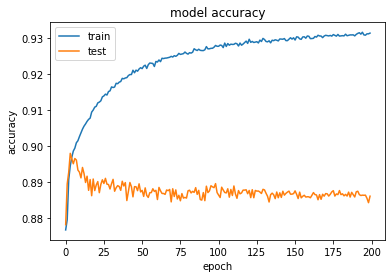

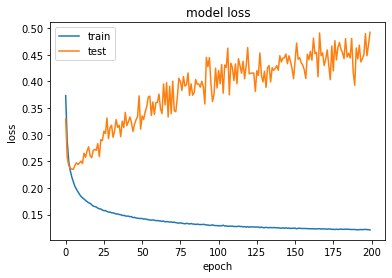

The confusion matrix is: [[30665  2510]
 [ 1892  2733]]
The accuracy score with test data is= 0.8832539682539683


In [ ]:
# Initialising the ANN
classifier_1 = Sequential()

# Adding the input layer and the first hidden layer
classifier_1.add(Dense(units = 512, kernel_initializer = 'uniform',activation='relu',input_dim = 409))
classifier_1.add(Dropout(0.2))
# Adding the second hidden layer
classifier_1.add(Dense(units = 32, kernel_initializer = 'uniform',activation='relu'))
classifier_1.add(Dropout(0.2))
classifier_1.add(Dense(units = 32, kernel_initializer = 'uniform',activation='relu'))
classifier_1.add(Dropout(0.2))
classifier_1.add(Dense(units = 32, kernel_initializer = 'uniform',activation='relu'))
# classifier.add(Dropout(0.2))
classifier_1.add(Dense(units = 32, kernel_initializer = 'uniform',activation='relu'))
# Adding the output layer
classifier_1.add(Dense(units = 2, kernel_initializer = 'uniform', activation = 'sigmoid'))

# Compiling the ANN

classifier_1.compile(optimizer = 'Adam', loss='binary_crossentropy', metrics = ['accuracy'])

# Fitting the ANN to the Training set
model_history=classifier_1.fit(X_train, y_train,validation_split = 0.15, batch_size =250, epochs = 200)

# list all data in history

print(model_history.history.keys())
#summarize history for accuracy
plt.plot(model_history.history['accuracy'])
plt.plot(model_history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

# summarize history for loss
plt.plot(model_history.history['loss'])
plt.plot(model_history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

# Part 3 - Making the predictions and evaluating the model

# Predicting the Test set results
y_pred = classifier_1.predict(X_test)
y_pred = (y_pred > 0.5)

# Making the Confusion Matrix
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test.argmax(axis=1), y_pred.argmax(axis=1))
print("The confusion matrix is:",cm) ##plot confusion matrix
# Calculate the Accuracy
from sklearn.metrics import accuracy_score
score = accuracy_score(y_pred,y_test)
print("The accuracy score with test data is=",score)

# estimator = KerasClassifier(build_fn=classifier, epochs= 30, batch_size=5, verbose=0)
# kfold = KFold(n_splits=10, shuffle=True)
# results = cross_val_score(estimator, X_test, y_test, cv=kfold)
# print("Baseline: %.2f%% (%.2f%%)" % (results.mean()*100, results.std()*100))
#88.88

In [ ]:
def build_model(hp):
    model = keras.Sequential()
    for i in range(hp.Int('num_layers', 2, 20)):
        model.add(layers.Dense(units=hp.Int('units_' + str(i),
                                            min_value=32,
                                            max_value=512,
                                            step=32),
                               activation='relu'))
    model.add(layers.Dense(4, activation='softmax'))
    model.compile(
        optimizer=keras.optimizers.Adam(
            hp.Choice('learning_rate', [1e-2, 1e-3, 1e-4])),
            loss=keras.losses.SparseCategoricalCrossentropy(from_logits=True),
            metrics=['accuracy'])
    return model

In [ ]:
tuner = RandomSearch(
    build_model,
    objective='val_accuracy',
    max_trials=5,
    executions_per_trial=3,
    directory='project',
    project_name='Corrosion_Prediction_3')

NameError: ignored

# SGD

In [ ]:
from sklearn.linear_model import SGDClassifier

In [ ]:
scaler = StandardScaler()
scaler.fit(x_train)  # Don't cheat - fit only on training data
X_train = scaler.transform(x_train)
X_test = scaler.transform(x_test)  # apply same transformation to test data


In [ ]:
clf = SGDClassifier(loss="log", penalty="l2", max_iter=5)
clf.fit(X_train, y_train)

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_stochastic_gradient.py:557: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  ConvergenceWarning)


SGDClassifier(alpha=0.0001, average=False, class_weight=None,
              early_stopping=False, epsilon=0.1, eta0=0.0, fit_intercept=True,
              l1_ratio=0.15, learning_rate='optimal', loss='log', max_iter=5,
              n_iter_no_change=5, n_jobs=None, penalty='l2', power_t=0.5,
              random_state=None, shuffle=True, tol=0.001,
              validation_fraction=0.1, verbose=0, warm_start=False)

In [ ]:
clf.score(X_train,y_train)

0.8771230158730159

In [ ]:
clf.score(X_test,y_test)

0.8765079365079365

In [ ]:
loss = ['hinge', 'log', 'modified_huber', 'squared_hinge',  
'perceptron'] 
penalty = ['l1', 'l2', 'elasticnet'] 
alpha = [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000] 
learning_rate = ['constant', 'optimal', 'invscaling', 'adaptive'] 
class_weight = [{1:0.5, 0:0.5}, {1:0.4, 0:0.6}, {1:0.6, 0:0.4}, {1:0.7, 0:0.3}]
eta0 = [1, 10, 100] 
param_distributions = dict(loss=loss, 
penalty=penalty, 
alpha=alpha, 
learning_rate=learning_rate, 
class_weight=class_weight, 
eta0=eta0) 
from sklearn.linear_model import SGDClassifier 
from sklearn.model_selection import RandomizedSearchCV 
sgd = SGDClassifier(loss="hinge", penalty="l2", max_iter=5) 
random = RandomizedSearchCV(estimator=sgd, 
param_distributions=param_distributions, 
scoring='roc_auc', 
verbose=1, n_jobs=-1, 
n_iter=1000) 
random_result = random.fit(X_train, y_train) 
print('Best Score: ', random_result.best_score_) 
print('Best Params: ', random_result.best_params_) 

Fitting 5 folds for each of 1000 candidates, totalling 5000 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:   11.9s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:   43.2s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:  2.7min
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:  4.2min
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:  6.0min
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:  8.1min
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed: 10.6min
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed: 13.3min
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed: 16.3min
[Parallel(n_jobs=-1)]: Done 5000 out of 5000 | elapsed: 16.4min finished
/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel(

Best Score:  0.550059642183659
Best Params:  {'penalty': 'l2', 'loss': 'log', 'learning_rate': 'optimal', 'eta0': 10, 'class_weight': {1: 0.6, 0: 0.4}, 'alpha': 0.01}


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_stochastic_gradient.py:557: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  ConvergenceWarning)


In [ ]:
clf = SGDClassifier(penalty= 'l2', loss= 'log', learning_rate='optimal', eta0= 10, class_weight= {1: 0.6, 0: 0.4}, alpha= 0.01, max_iter=5)
clf.fit(X_train, y_train)

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_stochastic_gradient.py:557: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  ConvergenceWarning)


SGDClassifier(alpha=0.01, average=False, class_weight={0: 0.4, 1: 0.6},
              early_stopping=False, epsilon=0.1, eta0=10, fit_intercept=True,
              l1_ratio=0.15, learning_rate='optimal', loss='log', max_iter=5,
              n_iter_no_change=5, n_jobs=None, penalty='l2', power_t=0.5,
              random_state=None, shuffle=True, tol=0.001,
              validation_fraction=0.1, verbose=0, warm_start=False)

In [ ]:
clf.score(X_train,y_train)

0.8771230158730159

In [ ]:
clf.score(X_test,y_test)

0.8765079365079365

In [ ]:
roc_auc_score(y_test,model.predict(X_test))

0.5013596001597722

# XGB

In [ ]:
xgb = XGBClassifier(learning_rate=0.01, n_estimators=300)
xgb.fit(x_train, y_train)
print(xgb.score(x_train,y_train))
xgb.score(x_test,y_test)

/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:235: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:268: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.8771230158730159


0.8765079365079365

In [ ]:
roc_auc_score(y_test,xgb.predict(x_test))

0.5

In [ ]:
def modelfit(alg, dtrain, predictors, useTrainCV=True, cv_folds=5, early_stopping_rounds=50):
    
    if useTrainCV:
        xgb_param = alg.get_xgb_params()
        xgtrain = xgb.DMatrix(dtrain[predictors].values, label=dtrain['risk_flag'].values)
        cvresult = xgb.cv(xgb_param, xgtrain, num_boost_round=alg.get_params()['n_estimators'], nfold=cv_folds,
            metrics='auc', early_stopping_rounds=early_stopping_rounds)
        alg.set_params(n_estimators=cvresult.shape[0])
    
    #Fit the algorithm on the data
    alg.fit(dtrain[predictors], dtrain['risk_flag'],eval_metric='auc')
        
    #Predict training set:
    dtrain_predictions = alg.predict(dtrain[predictors])
    dtrain_predprob = alg.predict_proba(dtrain[predictors])[:,1]
        
    #Print model report:
    print("\nModel Report")
    print("Accuracy : %.4g" % metrics.accuracy_score(dtrain['risk_flag'].values, dtrain_predictions))
    print("AUC Score (Train): %f" % metrics.roc_auc_score(dtrain['risk_flag'], dtrain_predprob))
                    
    feat_imp = pd.Series((alg.booster().get_fscore()).sort_values(ascending=False))
    feat_imp.plot(kind='bar', title='Feature Importances')
    plt.ylabel('Feature Importance Score')

In [ ]:
#Choose all predictors except target & IDcols
predictors = [x for x in train_data.columns if x not in ['risk_flag']]
xgb1 = XGBClassifier(
 learning_rate =0.1,
 n_estimators=1000,
 max_depth=5,
 min_child_weight=1,
 gamma=0,
 subsample=0.8,
 colsample_bytree=0.8,
 objective= 'binary:logistic',
 nthread=4,
 scale_pos_weight=1,
 seed=27)
modelfit(xgb1, train_data, predictors)


Model Report
Accuracy : 0.8997
AUC Score (Train): 0.935357


TypeError: ignored

In [ ]:
param_test1 = {
 'max_depth':range(3,10,2),
 'min_child_weight':range(1,6,2)
}
gsearch1 = GridSearchCV(estimator = XGBClassifier( learning_rate =0.1, n_estimators=140, max_depth=5,
 min_child_weight=1, gamma=0, subsample=0.8, colsample_bytree=0.8,
 objective= 'binary:logistic', nthread=4, scale_pos_weight=1, seed=27), 
 param_grid = param_test1, scoring='roc_auc',n_jobs=4,iid=False, cv=5)
gsearch1.fit(x_train,y_train)
gsearch1.grid_scores_, gsearch1.best_params_, gsearch1.best_score_

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_search.py:823: FutureWarning: The parameter 'iid' is deprecated in 0.22 and will be removed in 0.24.
  "removed in 0.24.", FutureWarning
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:235: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:268: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


AttributeError: ignored

In [ ]:
gsearch1.cv_results_, gsearch1.best_params_, gsearch1.best_score_

({'mean_fit_time': array([ 41.70196333,  41.95734968,  41.83195596,  67.23372955,
          67.23228436,  66.23875957,  96.36596317,  95.27816257,
          96.08666091, 130.15251942, 127.61866798, 112.19649067]),
  'mean_score_time': array([0.56107073, 0.55444102, 0.51246042, 0.93717961, 0.89509373,
         0.92824426, 1.27476635, 1.29423819, 1.38712592, 1.77936473,
         1.85897245, 1.07618432]),
  'mean_test_score': array([0.67089974, 0.67058451, 0.66903896, 0.8078375 , 0.80706628,
         0.807992  , 0.88212738, 0.88119012, 0.87946147, 0.91076563,
         0.90706869, 0.90523718]),
  'param_max_depth': masked_array(data=[3, 3, 3, 5, 5, 5, 7, 7, 7, 9, 9, 9],
               mask=[False, False, False, False, False, False, False, False,
                     False, False, False, False],
         fill_value='?',
              dtype=object),
  'param_min_child_weight': masked_array(data=[1, 3, 5, 1, 3, 5, 1, 3, 5, 1, 3, 5],
               mask=[False, False, False, False, False, Fals

In [ ]:
param_test2 = {
 'max_depth':[8,9,10],
 'min_child_weight':[0,1,2]
}
gsearch2 = GridSearchCV(estimator = XGBClassifier( learning_rate=0.1, n_estimators=140, max_depth=5,
 min_child_weight=2, gamma=0, subsample=0.8, colsample_bytree=0.8,
 objective= 'binary:logistic', nthread=4, scale_pos_weight=1,seed=27), 
 param_grid = param_test2, scoring='roc_auc',n_jobs=4,iid=False, cv=5)
gsearch2.fit(x_train,y_train)
gsearch1.cv_results_, gsearch1.best_params_, gsearch1.best_score_

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_search.py:823: FutureWarning: The parameter 'iid' is deprecated in 0.22 and will be removed in 0.24.
  "removed in 0.24.", FutureWarning
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:235: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:268: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


({'mean_fit_time': array([ 41.70196333,  41.95734968,  41.83195596,  67.23372955,
          67.23228436,  66.23875957,  96.36596317,  95.27816257,
          96.08666091, 130.15251942, 127.61866798, 112.19649067]),
  'mean_score_time': array([0.56107073, 0.55444102, 0.51246042, 0.93717961, 0.89509373,
         0.92824426, 1.27476635, 1.29423819, 1.38712592, 1.77936473,
         1.85897245, 1.07618432]),
  'mean_test_score': array([0.67089974, 0.67058451, 0.66903896, 0.8078375 , 0.80706628,
         0.807992  , 0.88212738, 0.88119012, 0.87946147, 0.91076563,
         0.90706869, 0.90523718]),
  'param_max_depth': masked_array(data=[3, 3, 3, 5, 5, 5, 7, 7, 7, 9, 9, 9],
               mask=[False, False, False, False, False, False, False, False,
                     False, False, False, False],
         fill_value='?',
              dtype=object),
  'param_min_child_weight': masked_array(data=[1, 3, 5, 1, 3, 5, 1, 3, 5, 1, 3, 5],
               mask=[False, False, False, False, False, Fals

In [ ]:
param_test3 = {
 'gamma':[i/10.0 for i in range(0,5)]
}
gsearch3 = GridSearchCV(estimator = XGBClassifier( learning_rate =0.1, n_estimators=140, max_depth=4,
 min_child_weight=6, gamma=0, subsample=0.8, colsample_bytree=0.8,
 objective= 'binary:logistic', nthread=4, scale_pos_weight=1,seed=27), 
 param_grid = param_test3, scoring='roc_auc',n_jobs=4,iid=False, cv=5)
gsearch3.fit(x_train,y_train)
gsearch3.cv_results_, gsearch3.best_params_, gsearch3.best_score_

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_search.py:823: FutureWarning: The parameter 'iid' is deprecated in 0.22 and will be removed in 0.24.
  "removed in 0.24.", FutureWarning
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:235: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:268: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


({'mean_fit_time': array([52.82628832, 52.9872385 , 53.0016983 , 53.15474868, 45.32294765]),
  'mean_score_time': array([0.76405559, 0.73558235, 0.76185598, 0.79083538, 0.58958712]),
  'mean_test_score': array([0.74031797, 0.74037637, 0.7412372 , 0.73978854, 0.74007314]),
  'param_gamma': masked_array(data=[0.0, 0.1, 0.2, 0.3, 0.4],
               mask=[False, False, False, False, False],
         fill_value='?',
              dtype=object),
  'params': [{'gamma': 0.0},
   {'gamma': 0.1},
   {'gamma': 0.2},
   {'gamma': 0.3},
   {'gamma': 0.4}],
  'rank_test_score': array([3, 2, 1, 5, 4], dtype=int32),
  'split0_test_score': array([0.73797467, 0.73806391, 0.73627624, 0.73626435, 0.73626435]),
  'split1_test_score': array([0.74416436, 0.74555848, 0.74595858, 0.74074151, 0.74074228]),
  'split2_test_score': array([0.74157016, 0.74156089, 0.74200128, 0.73966513, 0.74058833]),
  'split3_test_score': array([0.74137021, 0.73923683, 0.74449274, 0.74328601, 0.74328601]),
  'split4_test_score':